<font size="+3"><mark>Signal reconstruction benchmark / Explore the reconstruction error results</mark></font>

# Introduction

## README

_Associated GitHub repository: https://github.com/sylvaincom/astride._

The reconstructed signals and the reconstruction errors must have already been computed.

## Imports

In [1]:
import plotly.express as px
import plotly.graph_objs as go
import numpy as np
import numpy.ma as ma
import pandas as pd
from pathlib import Path

from src.utils import concatenate_df, create_path

## Configuration parameters

In [2]:
DATE_EXP_REC = "2023_02_08"
DATE_EXP_FIG = DATE_EXP_REC
DENOMS = [3, 4, 5, 6, 10, 15, 20]
IS_SAVEFIG = True

In [3]:
cwd = Path.cwd()

# For plotly:
layout = go.Layout(
    margin=go.layout.Margin(
        l=0, #left margin
        r=0, #right margin
        b=0, #bottom margin
        t=0, #top margin
    )
)

# Load the results

In [4]:
d_denoms = dict()
l_df_reconstruct_err_alldatasets_denom = list()

for denom in DENOMS:
    path_denom = Path(cwd / "results" / DATE_EXP_REC / "reconstruction" / str(denom))
    l_df_reconstruct_err_all_methods_denom = list(path_denom.rglob("reconstruction_errors_*.csv"))
    df_reconstruct_err_alldatasets_denom = concatenate_df(l_df_reconstruct_err_all_methods_denom).drop_duplicates()
    l_df_reconstruct_err_alldatasets_denom.append(df_reconstruct_err_alldatasets_denom)
df_reconstruct_err_alldatasets_alldenoms = (
    pd.concat(l_df_reconstruct_err_alldatasets_denom, ignore_index=True)
)

In [5]:
df_reconstruct_err_alldatasets_alldenoms.head()

,method,signal_index,trunc_eucl_error,trunc_dtw_error,denom,dataset,abba_tol,n_symbols,nsegments_abba,n_segments,n_samples,memory_usage_ratio_perc
0,SAX,0,3.139822,2.767765,3,ArrowHead,0.05,9,34,31,251,12.350598
1,SAX,1,3.087318,2.963532,3,ArrowHead,0.05,9,14,31,251,12.350598
2,SAX,2,3.145988,2.878219,3,ArrowHead,0.05,9,17,31,251,12.350598
3,SAX,3,3.486924,3.029083,3,ArrowHead,0.05,9,46,31,251,12.350598
4,SAX,4,2.760807,2.460788,3,ArrowHead,0.05,9,21,31,251,12.350598


In [6]:
df_reconstruct_err_alldatasets_alldenoms["dataset"].nunique()

69

In [7]:
sorted(df_reconstruct_err_alldatasets_alldenoms["denom"].unique())

[3, 4, 5, 6, 10, 15, 20]

In [8]:
# Get the number of data sets per denom:
d_unique_datasets_per_denom = dict()
d_ndatasets_per_denom = dict()
for (denom, df) in zip(DENOMS, l_df_reconstruct_err_alldatasets_denom):
    d_ndatasets_per_denom[denom] = df["dataset"].nunique()
    d_unique_datasets_per_denom[denom] = df["dataset"].unique().tolist()
df_denom_ndatasets = (
    pd.DataFrame.from_dict(d_ndatasets_per_denom, orient="index").reset_index()
    .rename(columns={"index":"denom", 0:"n_datasets"})
)
df_denom_ndatasets

,denom,n_datasets
0,3,69
1,4,67
2,5,65
3,6,64
4,10,56
5,15,49
6,20,44


In [9]:
# Get the common number of data sets for all denoms
df_117_datasets = pd.read_csv(cwd / "data/DataSummary_prep_equalsize_min100samples.csv")
l_117_datasets = df_117_datasets["Name"].unique().tolist()
l_common_datasets = l_117_datasets.copy()  # initialization
for denom in DENOMS:
    l_common_datasets = [
        dataset for dataset in l_common_datasets
        if dataset in d_unique_datasets_per_denom[denom]
    ]

n_datasets = len(l_common_datasets)
print(f"\nNumber of common datasets:\n\t{n_datasets}")

print("\nNO FILTERING ON THE DATA SETS IS PERFORMED")
#df_reconstruct_err_alldatasets_alldenoms_common = df_reconstruct_err_alldatasets_alldenoms.query(f"dataset in {l_common_datasets}")


Number of common datasets:
	44

NO FILTERING ON THE DATA SETS IS PERFORMED


In [10]:
# Creating the `target_memory_usage_ratio_perc` feature
df_reconstruct_err_alldatasets_alldenoms["target_memory_usage_ratio_perc"] = (
    1 / df_reconstruct_err_alldatasets_alldenoms["denom"] * 100
)

In [11]:
# Get the mean target and mean empirical memory usage ratio per denom (for all signals whatever their data set)
d_denom_memory_usage_ratio = dict()

for denom in DENOMS:
    df_denom = df_reconstruct_err_alldatasets_alldenoms.query(f"denom == {denom}")
    # Target memory usage ratio
    target_memory_usage_ratio_perc = 1/denom*100
    # Mean memory usage ratio accross all signals of all data sets
    memory_usage_ratio_perc_mean = df_denom["memory_usage_ratio_perc"].mean()
    # Create a dictionary
    d_denom_memory_usage_ratio[denom] = [target_memory_usage_ratio_perc, memory_usage_ratio_perc_mean]
    
d_rename = {"index":"denom", 0:"target_memory_usage_ratio_perc", 1:"emp_memory_usage_ratio_perc"}
df_denom_emptau = (
    pd.DataFrame.from_dict(d_denom_memory_usage_ratio, orient="index")
    .reset_index()
    .rename(columns=d_rename)
)
df_denom_emptau.round(2)

,denom,target_memory_usage_ratio_perc,emp_memory_usage_ratio_perc
0,3,33.33,19.34
1,4,25.00,15.83
2,5,20.00,13.40
3,6,16.67,11.68
4,10,10.00,7.60
5,15,6.67,5.29
6,20,5.00,4.01


In [12]:
df_denom_info = df_denom_emptau.merge(df_denom_ndatasets, on="denom", how="left").sort_values(by=["target_memory_usage_ratio_perc"])
df_denom_info.round(1)

,denom,target_memory_usage_ratio_perc,emp_memory_usage_ratio_perc,n_datasets
6,20,5.0,4.0,44
5,15,6.7,5.3,49
4,10,10.0,7.6,56
3,6,16.7,11.7,64
2,5,20.0,13.4,65
1,4,25.0,15.8,67
0,3,33.3,19.3,69


*Note*: It corresponds to Table 5 of the paper.

# Explore all results of all methods and target memory usage ratios

In [13]:
d_rename = {"trunc_eucl_error":"euclidean_error", "trunc_dtw_error":"dtw_error"}
df_errors = df_reconstruct_err_alldatasets_alldenoms.rename(columns=d_rename).copy()

In [14]:
df_errors.head()

,method,signal_index,euclidean_error,dtw_error,denom,dataset,abba_tol,n_symbols,nsegments_abba,n_segments,n_samples,memory_usage_ratio_perc,target_memory_usage_ratio_perc
0,SAX,0,3.139822,2.767765,3,ArrowHead,0.05,9,34,31,251,12.350598,33.333333
1,SAX,1,3.087318,2.963532,3,ArrowHead,0.05,9,14,31,251,12.350598,33.333333
2,SAX,2,3.145988,2.878219,3,ArrowHead,0.05,9,17,31,251,12.350598,33.333333
3,SAX,3,3.486924,3.029083,3,ArrowHead,0.05,9,46,31,251,12.350598,33.333333
4,SAX,4,2.760807,2.460788,3,ArrowHead,0.05,9,21,31,251,12.350598,33.333333


## Prepare the data for plotting

In [15]:
df_errors.head()

,method,signal_index,euclidean_error,dtw_error,denom,dataset,abba_tol,n_symbols,nsegments_abba,n_segments,n_samples,memory_usage_ratio_perc,target_memory_usage_ratio_perc
0,SAX,0,3.139822,2.767765,3,ArrowHead,0.05,9,34,31,251,12.350598,33.333333
1,SAX,1,3.087318,2.963532,3,ArrowHead,0.05,9,14,31,251,12.350598,33.333333
2,SAX,2,3.145988,2.878219,3,ArrowHead,0.05,9,17,31,251,12.350598,33.333333
3,SAX,3,3.486924,3.029083,3,ArrowHead,0.05,9,46,31,251,12.350598,33.333333
4,SAX,4,2.760807,2.460788,3,ArrowHead,0.05,9,21,31,251,12.350598,33.333333


In [16]:
df_errors.query("dataset == 'ArrowHead'")["signal_index"].nunique()

36

In [17]:
# The groupby is done on the target memory usage ratios
df_errors_mean = (
    df_errors
    .groupby(by=["target_memory_usage_ratio_perc", "method"])
    [["euclidean_error", "dtw_error"]]
    .mean()
    .reset_index()
    .rename(columns={"euclidean_error":"mean_euclidean_error", "dtw_error":"mean_dtw_error"})
)
df_errors_std = (
    df_errors
    .groupby(by=["target_memory_usage_ratio_perc", "method"])
    [["euclidean_error", "dtw_error"]]
    .std()
    .reset_index()
    .rename(columns={"euclidean_error":"std_euclidean_error", "dtw_error":"std_dtw_error"})
)

In [18]:
df_errors_plot = (
    df_errors_mean
    .merge(df_errors_std, on=["target_memory_usage_ratio_perc", "method"])
)

In [19]:
df_errors_info_plot = df_errors_plot.merge(df_denom_info, on=["target_memory_usage_ratio_perc"])
df_errors_info_plot.round(2).sample(5)

,target_memory_usage_ratio_perc,method,mean_euclidean_error,mean_dtw_error,std_euclidean_error,std_dtw_error,denom,emp_memory_usage_ratio_perc,n_datasets
20,16.67,ASTRIDE,9.25,7.86,5.96,5.45,6,11.68,64
22,16.67,SAX,10.36,8.94,5.71,5.43,6,11.68,64
4,5.00,SAX,17.25,15.49,6.57,6.73,20,4.01,44
23,16.67,SFA,6.93,4.89,6.09,5.62,6,11.68,64
5,5.00,SFA,15.01,12.80,8.52,9.18,20,4.01,44


## Comparing the methods

### Error vs memory usage ratio

In [20]:
def plot_reconstruction_benchmark(euclidean_or_dtw, df_errors_info_plot, is_savefig, date_exp_fig):
    
    fig = px.scatter(
        df_errors_info_plot.round(2),
        x="emp_memory_usage_ratio_perc",
        y="mean_"+euclidean_or_dtw+"_error",
        color="method",
        hover_data=["n_datasets", "denom", "std_"+euclidean_or_dtw+"_error"],
        category_orders={"method": ["SAX", "1d-SAX", "SFA", "ABBA", "ASTRIDE", "FASTRIDE"]},
        width=800,
        height=350,
        labels={
            "emp_memory_usage_ratio_perc": "Empirical memory usage ratio (%)",
            "mean_euclidean_error": "Mean Euclidean error",
            "mean_dtw_error": "Mean DTW error",
            "method":"Method",
        },
    )
    fig.update_traces(mode='markers+lines')
    fig.update_layout(layout)
    if is_savefig:
        cwd = Path.cwd()
        folder = Path(cwd / "results" / date_exp_fig / "img")
        create_path(folder)
        fig.write_image(folder / f"reconstruction_benchmark_{euclidean_or_dtw}_mean_trunc.png", width=800, height=350, scale=2)
    fig.show()

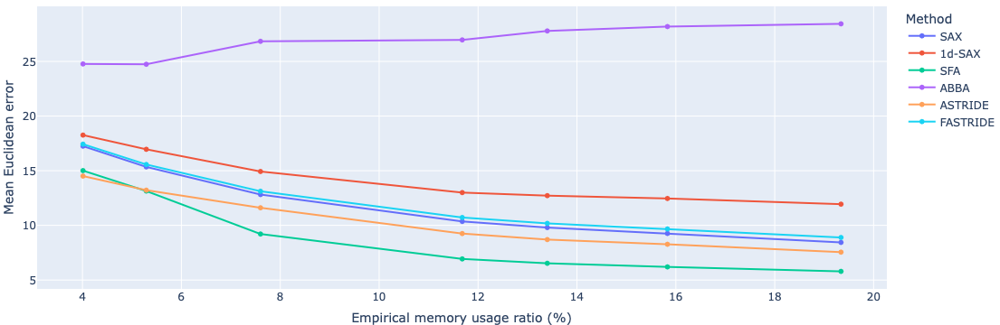

In [21]:
plot_reconstruction_benchmark("euclidean", df_errors_info_plot, IS_SAVEFIG, DATE_EXP_FIG)

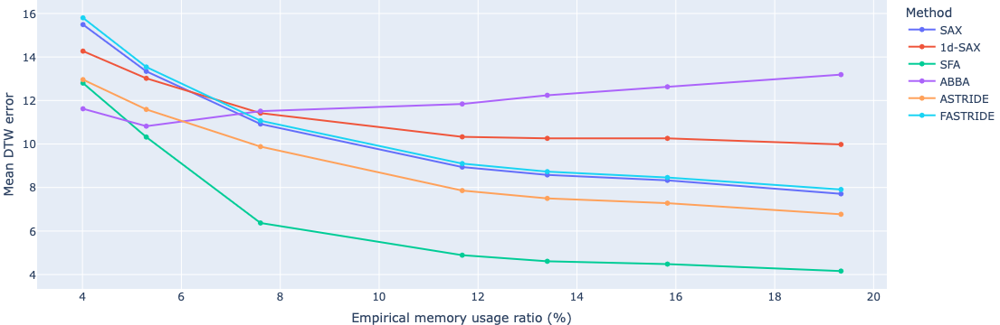

In [22]:
plot_reconstruction_benchmark("dtw", df_errors_info_plot, IS_SAVEFIG, DATE_EXP_FIG)

*Note*: It corresponds to Figure 6.

### Box-plot

In [23]:
denom = 15
df_denom = df_denom_info[df_denom_info.denom == denom]
emp_memory_usage_ratio_perc = df_denom["emp_memory_usage_ratio_perc"].iloc[0]
display(df_denom.round(2))

,denom,target_memory_usage_ratio_perc,emp_memory_usage_ratio_perc,n_datasets
5,15,6.67,5.29,49


In [24]:
def plot_boxplot_reconstruction_benchmark(denom, euclidean_or_dtw, df_errors, is_savefig, date_exp_fig):

    err_msg = "Choose 'euclidean' or 'dtw'."
    assert euclidean_or_dtw in ["euclidean", "dtw"], err_msg
    
    df_errors_denom = df_errors.query(f"denom == {denom}")
    
    if euclidean_or_dtw=="euclidean":
        max_euclidean = df_errors_denom["euclidean_error"].quantile(0.9999)
        df_plot = df_errors_denom.query(f"euclidean_error <= {max_euclidean}")
    elif euclidean_or_dtw=="dtw":
        max_dtw = df_errors_denom["dtw_error"].quantile(0.9999)
        df_plot = df_errors_denom.query(f"dtw_error <= {max_dtw}")
        
    fig = px.box(
        df_plot,
        x="method",
        y=euclidean_or_dtw+"_error",
        category_orders={"method": ["SAX", "1d-SAX", "SFA", "ABBA", "ASTRIDE", "FASTRIDE"]},
        width=500,
        height=350,
        labels={
            "euclidean_error": "Euclidean error",
            "dtw_error": "DTW error",
            "method":"Method",
        },
    )
    fig.update_traces(quartilemethod="linear")
    fig.update_layout(layout)
    if is_savefig:
        cwd = Path.cwd()
        folder = Path(cwd / "results" / date_exp_fig / "img")
        create_path(folder)
        fig.write_image(folder / f"reconstruction_benchmark_denom{denom}_{euclidean_or_dtw}_boxplot_trunc.png", width=500, height=350, scale=2)
    fig.show()

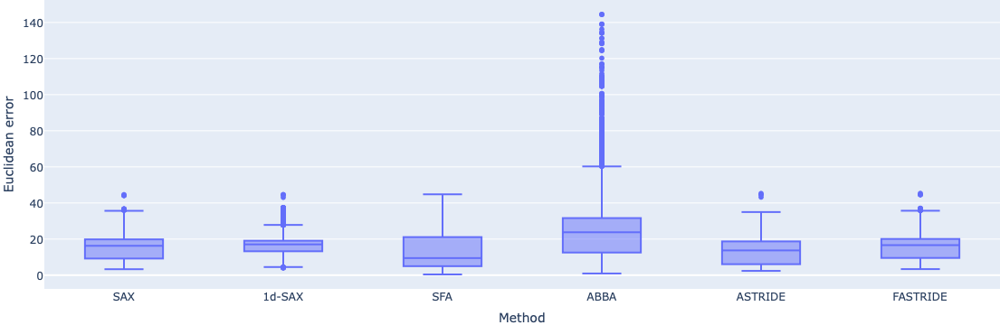

In [25]:
plot_boxplot_reconstruction_benchmark(
    denom=denom,
    euclidean_or_dtw="euclidean",
    df_errors=df_errors,
    is_savefig=IS_SAVEFIG,
    date_exp_fig=DATE_EXP_FIG,
)

*Note*: It corresponds to Figure 7 of the paper.

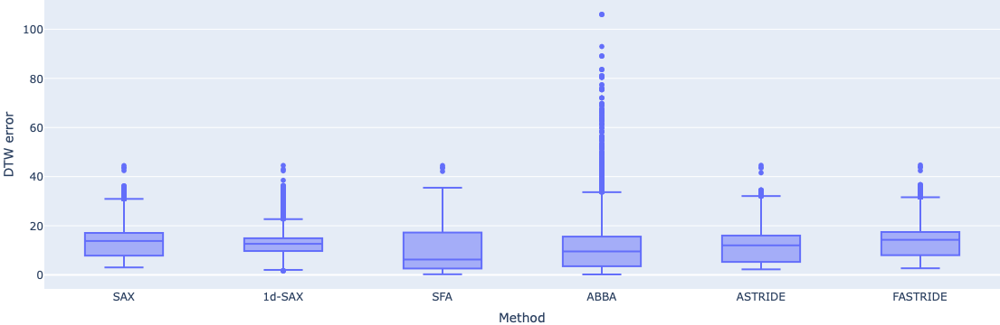

In [26]:
plot_boxplot_reconstruction_benchmark(
    denom=denom,
    euclidean_or_dtw="dtw",
    df_errors=df_errors,
    is_savefig=IS_SAVEFIG,
    date_exp_fig=DATE_EXP_FIG,
)

*Note*: It corresponds to Figure 7 of the paper.